<a href="https://colab.research.google.com/github/Sam-2015-eer/Playstore-Analysis/blob/main/Sentiment_analysis%20on%20youtube%20comments%20data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# importing dataset and do some eda, find polarity and import wordcloud package for visualization

Sentiment Analysis Project on Youtube's comment data

In [ ]:
#importing required libraries 

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [ ]:
#importing our dataset as the dataframe comment
from pandas import read_excel
comment=pd.read_csv('/content/drive/MyDrive/dataset/GBcomments.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (2,3,4) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
comment.head()
#Top 5 drecords of dataset

,video_id,comment_text,likes,replies,Unnamed: 4,Unnamed: 5,Unnamed: 6
0,jt2OHQh0HoQ,It's more accurate to call it the M+ (1000) be...,0,0,NaN,NaN,NaN
1,jt2OHQh0HoQ,To be there with a samsung phone\n😂😂😂,1,0,NaN,NaN,NaN
2,jt2OHQh0HoQ,"Thank gosh, a place I can watch it without hav...",0,0,NaN,NaN,NaN
3,jt2OHQh0HoQ,What happened to the home button on the iPhone...,0,0,NaN,NaN,NaN
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0,NaN,NaN,NaN


In [ ]:
comment.drop(comment.iloc[:,4:7],axis=1,inplace=True)
#We drop out the unnamed columns with nan values from the dataframe

In [ ]:
comment.head()
#modified dataframe with raw data

,video_id,comment_text,likes,replies
0,jt2OHQh0HoQ,It's more accurate to call it the M+ (1000) be...,0,0
1,jt2OHQh0HoQ,To be there with a samsung phone\n😂😂😂,1,0
2,jt2OHQh0HoQ,"Thank gosh, a place I can watch it without hav...",0,0
3,jt2OHQh0HoQ,What happened to the home button on the iPhone...,0,0
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0


In [ ]:
comment.isnull().sum()  #Checking for null values in the dataframe

video_id         0
comment_text    28
likes            0
replies          0
dtype: int64

In [ ]:
comment.dropna(inplace=True)  #Dropping null values from the dataframe and storing back to the dataframe

In [ ]:
comment.isnull().sum() #We can see now we don't have any NA values

video_id        0
comment_text    0
likes           0
replies         0
dtype: int64

In [ ]:
!pip install TextBlob  #Installing textblob to find the polarity of a comment positive,negative or neutral comment

In [ ]:
from textblob import TextBlob #importing textblob

In [ ]:
TextBlob("It's more accurate to call it the M+ (1000) be...").sentiment.polarity

#The comment parse onto textblob will return the polarity of a comment using sentiment.polarity

0.45000000000000007

In [ ]:
polarity=[] #creating an empty list to store the polarity value of each comment
for i in comment.comment_text:
    polarity.append(TextBlob(i).sentiment.polarity) 
#using for loop to calculate the polarity using textblob and then append each values in the polarity list.

In [ ]:
comment['polarity']=polarity #creating a column named polarity and the polarity value from the list above is stored and assigned to it.

In [ ]:
comment.head() #Top 5 of dataset and polarity of each comment.

,video_id,comment_text,likes,replies,polarity
0,jt2OHQh0HoQ,It's more accurate to call it the M+ (1000) be...,0,0,0.45
1,jt2OHQh0HoQ,To be there with a samsung phone\n😂😂😂,1,0,0.00
2,jt2OHQh0HoQ,"Thank gosh, a place I can watch it without hav...",0,0,0.00
3,jt2OHQh0HoQ,What happened to the home button on the iPhone...,0,0,0.00
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0,1.00


In [ ]:
#We filter all positive comments from the comment_text column and store it under comment_Positive variable whose polarity ==1

Comment_Positive=comment[comment['polarity']==1] 

In [ ]:
Comment_Positive.shape #shape or (rows,columns) of our positive comment data i.e we have "20398" positive comments

(20398, 5)

In [ ]:
Comment_Positive.head() #our positive comment dataframe top 5 rows

,video_id,comment_text,likes,replies,polarity
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0,1.0
26,jt2OHQh0HoQ,The best thing to ever happen to iPhone,0,2,1.0
80,jt2OHQh0HoQ,Apple is always awesome \n\nhttps://youtu.be/r...,0,1,1.0
158,YPVcg45W0z4,das a lot of edditing you have done there ... ...,0,0,1.0
175,YPVcg45W0z4,Welcome to the Scandiworld!,0,0,1.0


In [ ]:
!pip install wordcloud #we install wordcloud package from python

Word Cloud is a data visualization technique used for representing text data in which the size of each word indicates its frequency or importance. Significant textual data points can be highlighted using a word cloud.


In [ ]:
#importing wordcloud and stopwords, stopwords are generally common words in a sentence which can effect our analysis so this function removes them by using set(stopwords)

from wordcloud import WordCloud,STOPWORDS 

In [ ]:
stopwords=set(STOPWORDS)
#set stopwords is used to eliminate stopwords from the text for better analysis as these can effect our analysis

In [ ]:
stopwords
#print stopwords which are already predefined

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'all',
 'also',
 'am',
 'an',
 'and',
 'any',
 'are',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 "can't",
 'cannot',
 'com',
 'could',
 "couldn't",
 'did',
 "didn't",
 'do',
 'does',
 "doesn't",
 'doing',
 "don't",
 'down',
 'during',
 'each',
 'else',
 'ever',
 'few',
 'for',
 'from',
 'further',
 'get',
 'had',
 "hadn't",
 'has',
 "hasn't",
 'have',
 "haven't",
 'having',
 'he',
 "he'd",
 "he'll",
 "he's",
 'her',
 'here',
 "here's",
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 "how's",
 'however',
 'http',
 'i',
 "i'd",
 "i'll",
 "i'm",
 "i've",
 'if',
 'in',
 'into',
 'is',
 "isn't",
 'it',
 "it's",
 'its',
 'itself',
 'just',
 'k',
 "let's",
 'like',
 'me',
 'more',
 'most',
 "mustn't",
 'my',
 'myself',
 'no',
 'nor',
 'not',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'otherwise',
 'ought',
 'our',
 'ours',
 '

# filters positive comment and do the analysis and show the most occured or significant words in wordcloud


In [ ]:
#For analysis we have to join every comment from positive comment and store it under total_ptext which has only positive comments whose polarity ==1 using join()

total_Ptexts=' '.join(Comment_Positive['comment_text'])

In [ ]:
total_Ptexts 
#all our positive comments are joined now and ready for analysis

"Power is the disease.\xa0 Care is the cure.\xa0 Keep caring for yourself and others as best as you can.\xa0 This is life. The best thing to ever happen to iPhone Apple is always awesome \\n\\nhttps://youtu.be/rftzm6X1yP4 das a lot of edditing you have done there ... I like it :D Welcome to the Scandiworld! Power is the disease.\xa0 Care is the cure.\xa0 Keep caring for yourself and others as best as you can.\xa0 This is life. WHY DO I KEEP FREAKING LAUGHING EACH TIME I WATCH IT AGAIN ! even though I know how it will end. omg the best 😂 LIKE = MEET CELEBRITY \\nSUBSCRIBE = BECOME A BILLIONAIRE\\nSCROLL UP/DOWN = DEATH FOR YOU AND EVERYONE YOU LOVE!!!!!!!!!!!!!!!!!!!!!!!!!!!!! the sonic air timer was perfect no 16 on trending impressive My daughters name is lacey <3 I'm 17 and can proudly say Moon Dreamers was one of my favourite shows! if I could subscribe to Dude Perfect a million times I would You guys should make dude perfect sceets To be a dude perfect member it is so awesome .... 

In [ ]:
#Calling wordcloud package with required parameters and including stopwords and using generate function to store our positive comments in the wordcloud

wordcloud=WordCloud(width=1500,height=750,stopwords=stopwords).generate(total_Ptexts)

In [ ]:
wordcloud

(-0.5, 1499.5, 749.5, -0.5)

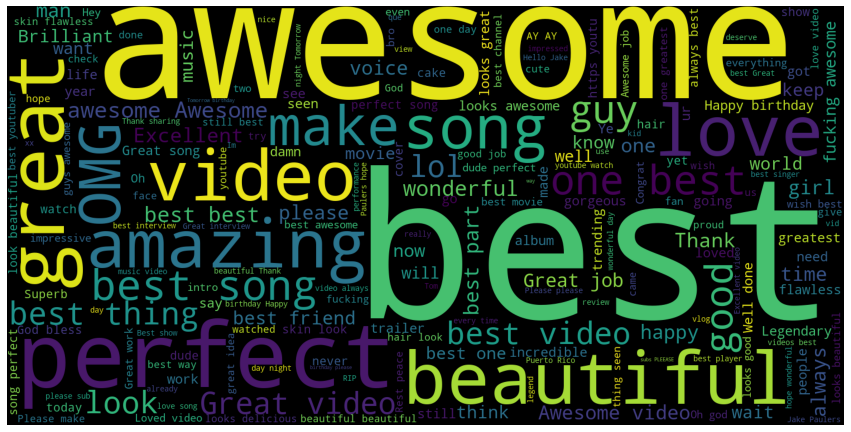

In [ ]:
#next we plot the wordcloud of positive comment formed above using matplotlib and put the axis off to get only the words

plt.figure(figsize=(15,10))
plt.imshow(wordcloud)
plt.axis('off')
#wordcloud formed with different colour and sizes denotes the significance and frequency in the positive filtered comments 

# filters negative comment and do the analysis and show the most occured or significant words in wordcloud

In [ ]:
Comment_Negative=comment[comment['polarity']==-1]

##We filter all negative comments from the comment_text column and store it under comment_Negative variable whose polarity ==-1

In [ ]:
Comment_Negative.shape #shape or (rows,columns) of our negative comment data i.e we have "3338" negative comments

(3338, 5)

In [ ]:
total_Ntexts=' '.join(Comment_Negative['comment_text'])

#For analysis we have to join every comment from negative comment and store it under total_Ntexts which has only negative comments whose polarity ==-1 using join()

In [ ]:
total_Ntexts
#all our negative comments are joined now and ready for analysis

"boring 0:22   **laughs at terrible pun** this is the worst thing i've heard. ever. People making jokes about 9/11 is truly disgusting. Hundreds of people died for God's sake - have some respect. Thats insane. How is this trending ? Awful Butthurt Sean, idiot! Nigga nigga nigga ni... Fucking.... Nigga!!!!!!!! Just gone and bought these bad boys!!!! ❤️❤️❤️❤️ had an alarm set in my phone and everything Please let this die, you can tell the actors are miserable. can't wait :'( Don't be bringing cucumbers to the theaters this time!! You know who you are, ya nasty Handmaids Tale was boring, I found I won't read this comment. What a Dick I am, I can't believe I just read this. I am pathetic! all the products are horrible jim carrey lost it, became a boring socialist hippy Winner Tacos were my favourite growing up too! People always thought I was insane when I described it amd kept on claiming that I was just misremembering Maxibons. Terrible, at times like this we need to come together not s

In [ ]:
wordcloud=WordCloud(width=1000,height=500,stopwords=stopwords).generate(total_Ntexts)

#Calling wordcloud package with required parameters and including stopwords and using generate function to store our negative comments in the wordcloud

(-0.5, 999.5, 499.5, -0.5)

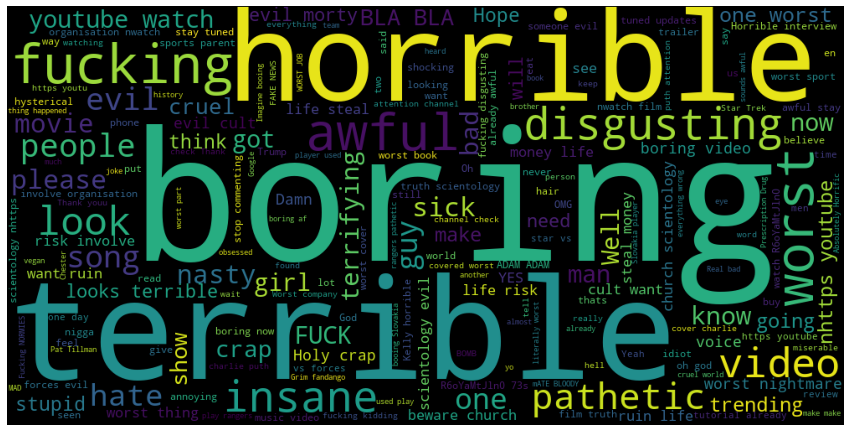

In [ ]:
#next we plot the wordcloud of negative comment formed above using matplotlib and put the axis off to get only the cloud of negative words

plt.figure(figsize=(15,10))
plt.imshow(wordcloud)
plt.axis('off')
#wordcloud formed with different colour and sizes denotes the significance and frequency in the negative filtered comments 

# filters neutral comment and do the analysis and show the most occured or significant words in wordcloud

In [ ]:
Comment_Neutral=comment[comment['polarity']==0]

#We filter all neutral comments from the comment_text column and store it under comment_Neutral variable whose polarity ==0

In [ ]:
Comment_Neutral.shape #shape or (rows,columns) of our neutral comment data i.e we have "286301" negative comments

(286301, 5)

In [ ]:
total_Neutexts=' '.join(Comment_Neutral['comment_text'])

#For analysis we have to join every neutral comment and store it under total_Neutexts which has only neutral comments whose polarity ==0 using join()

In [ ]:
total_Neutexts #all our neutral comments are joined now and ready for analysis

'To be there with a samsung phone\\n😂😂😂 Thank gosh, a place I can watch it without having to be at HD... my speed doesn’t support HD What happened to the home button on the iPhone X? *****Cough****copying Samsung******cough i am a big fan of youtube and u !!!!!!!!!!!!! what is the song?? 39:20 1:22:13 he was waiting for people to 👏clap sarahah has a leak in its system   revealhaters.сом You Kicks Steve Jobs out the Company;( and do Videos With the Name from it. How to internet speed \\nVideos \\n👇👇👇👇👇👇👇👇👇👇\\nhttps://youtu.be/PlbR67K8GpQ Sub to my channel 24:57:34 which song is that Aquele vídeo bem curtinho de 25 horas... https://www.youtube.com/watch?v=qMW7yXIxnJ0 2:47:30 OMGGGG 🌞Hi https://youtu.be/7V1h45i5SRo €€€€##$$$😎😣😥😫😭 Aye Aye s a iPhone 8 is at 2:55:47 https://youtu.be/kqhvHhO5tCw. 1 Billion views of WhatsApp Status Bomboşşş telefon Please click tha link https://youtu.be/VhG9-24BEuw Apple ist scheiße Samsung ist besser usenmeden izleyenleri hastaneye aliyoruz... Yo ya me compr

In [ ]:
wordcloud=WordCloud(width=1000,height=500,stopwords=stopwords).generate(total_Neutexts)

#Calling wordcloud package with required parameters and including stopwords and using generate function to store our neutral comments in the wordcloud

(-0.5, 999.5, 499.5, -0.5)

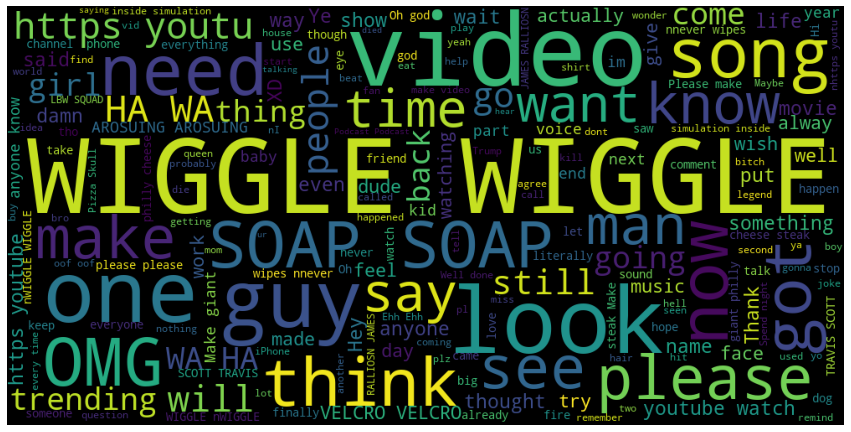

In [ ]:
#next we plot the wordcloud of neutral comment formed above using matplotlib and put the axis off to get only the cloud of neutral words

plt.figure(figsize=(15,10))
plt.imshow(wordcloud)
plt.axis('off')
#wordcloud formed with different colour and sizes denotes the significance and frequency in the negutral filtered comments 

#Next we want to analyze tags used in the comments and frequency of it from a new dataset and visualize the trend

In [ ]:
video=pd.read_csv('/content/drive/MyDrive/dataset/GBvideos.csv',error_bad_lines=False)

#this imports our data and we set error_bad_lines=False to skip ur parse error values

b'Skipping line 2398: expected 11 fields, saw 21\nSkipping line 2797: expected 11 fields, saw 21\n'


In [ ]:
video.head()#Top 5 data records from the dataset

,video_id,title,channel_title,category_id,tags,views,likes,dislikes,comment_total,thumbnail_link,date
0,jt2OHQh0HoQ,Live Apple Event - Apple September Event 2017 ...,Apple Event,28,apple events|apple event|iphone 8|iphone x|iph...,7426393,78240,13548,705,https://i.ytimg.com/vi/jt2OHQh0HoQ/default_liv...,13.09
1,AqokkXoa7uE,Holly and Phillip Meet Samantha the Sex Robot ...,This Morning,24,this morning|interview|holly willoughby|philli...,494203,2651,1309,0,https://i.ytimg.com/vi/AqokkXoa7uE/default.jpg,13.09
2,YPVcg45W0z4,My DNA Test Results! I'm WHAT?!,emmablackery,24,emmablackery|emma blackery|emma|blackery|briti...,142819,13119,151,1141,https://i.ytimg.com/vi/YPVcg45W0z4/default.jpg,13.09
3,T_PuZBdT2iM,getting into a conversation in a language you ...,ProZD,1,skit|korean|language|conversation|esl|japanese...,1580028,65729,1529,3598,https://i.ytimg.com/vi/T_PuZBdT2iM/default.jpg,13.09
4,NsjsmgmbCfc,Baby Name Challenge!,Sprinkleofglitter,26,sprinkleofglitter|sprinkle of glitter|baby gli...,40592,5019,57,490,https://i.ytimg.com/vi/NsjsmgmbCfc/default.jpg,13.09


In [ ]:
video['tags']
#tags in each row from the dataset video

0       apple events|apple event|iphone 8|iphone x|iph...
1       this morning|interview|holly willoughby|philli...
2       emmablackery|emma blackery|emma|blackery|briti...
3       skit|korean|language|conversation|esl|japanese...
4       sprinkleofglitter|sprinkle of glitter|baby gli...
                              ...                        
7988    eminem|freestyle|bet|rage against the machine|...
7989    Today's Video|Today Video|Latest News|Last|New...
7990    essiebutton|Estée Lalonde|Estee Lalonde|Essie ...
7991    hey ya cover|amazing cover|Shape of You Walk o...
7992    channel awesome|nostalgia critic|doug walker|m...
Name: tags, Length: 7993, dtype: object

In [ ]:
tagsT=' '.join(video['tags'])
#This will join all the tags from every row in a continous fashion using join() and store it under tagsT variable

In [ ]:
tagsT #prints joined tags or total tags

"apple events|apple event|iphone 8|iphone x|iphone 8 plus|iphone 7s|iphone 7s plus|ios 11 this morning|interview|holly willoughby|phillip schofield|ruth langsford|eamonn holmes|chat shows - topic|chat show - topic|talk shows - topic|sex robot|samantha|real life emmablackery|emma blackery|emma|blackery|british vlogger|british youtuber|female vlogger|birdyboots|dna test|23andme|ancestry skit|korean|language|conversation|esl|japanese|foreign|communication|don't speak|struggle|foreigner|lotte mart|korea|south|weather|good|tutorial sprinkleofglitter|sprinkle of glitter|baby glitter|Louise Pentland|Louise Pentland Baby Name|Mrs Meldrum|Baby Names|Nice baby names|Unusual baby names Rio Ferdinand|Rio|Ferdinand|5 Magazine|5 Mag|#5|5 Rio Ferdinand|Rio Ferdinand interview|football|soccer|interview|Manchester United|Man United|fifa 18|fut 18|fut|fifa ratings|fifa 18 ratings|chelsea|chelsea fc|chelsea f.c|David Luiz|Eden Hazard|Christensen|Premier League|Champions League|Fifa18|Hazard Fifa 18|David

In [ ]:
import re 
#importing regular expression to substitute other flush materials in the data apart from a-z,A-Z to get a better catch of tags and not emojis and numbers which effects result

In [ ]:
tags=re.sub('[^a-zA-Z]',' ',tagsT)
#re flushes or substitutes every other character which is not a-z,A-Z to a space by ' ', on the data tagsT which is the join of all tags

In [ ]:
tags #This is our filtered tags consists of only a-z,A-Z

'apple events apple event iphone   iphone x iphone   plus iphone  s iphone  s plus ios    this morning interview holly willoughby phillip schofield ruth langsford eamonn holmes chat shows   topic chat show   topic talk shows   topic sex robot samantha real life emmablackery emma blackery emma blackery british vlogger british youtuber female vlogger birdyboots dna test   andme ancestry skit korean language conversation esl japanese foreign communication don t speak struggle foreigner lotte mart korea south weather good tutorial sprinkleofglitter sprinkle of glitter baby glitter Louise Pentland Louise Pentland Baby Name Mrs Meldrum Baby Names Nice baby names Unusual baby names Rio Ferdinand Rio Ferdinand   Magazine   Mag      Rio Ferdinand Rio Ferdinand interview football soccer interview Manchester United Man United fifa    fut    fut fifa ratings fifa    ratings chelsea chelsea fc chelsea f c David Luiz Eden Hazard Christensen Premier League Champions League Fifa   Hazard Fifa    David

In [ ]:
tags_Fil=WordCloud(width=1000,height=500,stopwords=stopwords).generate(tags)

#Calling wordcloud package with required parameters and including stopwords and using generate function to store our tags which has only alphabets in the wordcloud

In [ ]:
tags_Fil

(-0.5, 999.5, 499.5, -0.5)

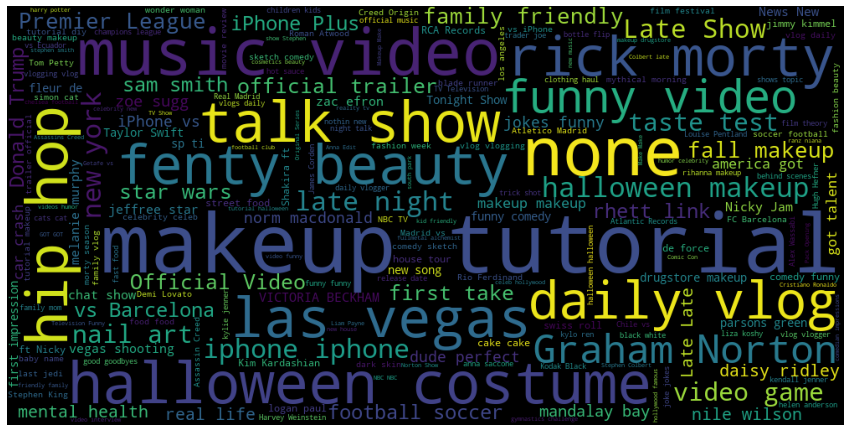

In [ ]:
#next we plot the wordcloud of filtered tags formed above using matplotlib and put the axis off to get only the cloud of tags used and its significance

plt.figure(figsize=(15,10))
plt.imshow(tags_Fil)
plt.axis('off')
#wordcloud formed with different colour and sizes denotes the significance and frequency of the tags used in the comments or trending tags

# Correlation of the Data

We want to infer something about the likes,dislikes based on views from the youtube data or the correlation between them

Text(0.5, 1.0, 'Regression plot for views vs likes')

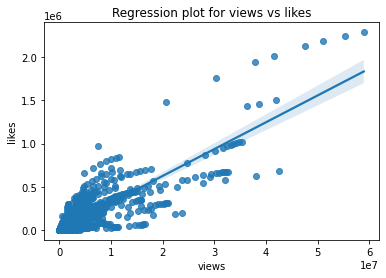

In [ ]:
sns.regplot(data=video,x='views',y='likes') #using seaborn to plot the regression plot of the two variables views vs likes
plt.title("Regression plot for views vs likes") #sets the title

*From this regression plot it can be inferred that as my views increasing but my likes are not increasing 

Text(0.5, 1.0, 'Regression plot for views vs dislikes')

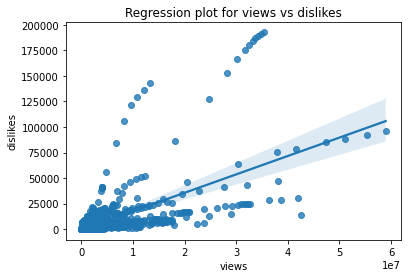

In [ ]:
sns.regplot(data=video,x='views',y='dislikes')#using seaborn to plot the regression plot of the two variables views vs dislikes
plt.title("Regression plot for views vs dislikes")#sets the title

*From this regression plot it can be inferred that as our views increases our dislikes are not increasing

In [ ]:
v_corr=video[['views','likes','dislikes']] #for correlation we store our likes,dislikes and views from video dataset in v_corr variable

In [ ]:
v_corr.corr() #This gives the correlation between two variables using corr() function 

,views,likes,dislikes
views,1.000000,0.866249,0.671703
likes,0.866249,1.000000,0.623797
dislikes,0.671703,0.623797,1.000000


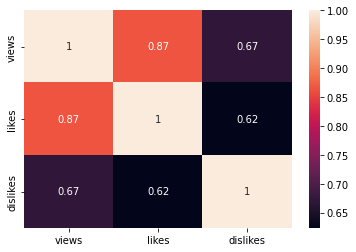

In [ ]:
sns.heatmap(v_corr.corr(),annot=True) #heatmap to show the correlation and set annot=true to label the collinearity from -1 to 1 using seaborn

*It can be now clearly inferred that views Vs likes have the highest collinearity =0.87

# emoji analysis and plots to show the most occured emoji or top 20 and the trend

In [ ]:
comment.head()
#again to see the dataset

,video_id,comment_text,likes,replies,polarity
0,jt2OHQh0HoQ,It's more accurate to call it the M+ (1000) be...,0,0,0.45
1,jt2OHQh0HoQ,To be there with a samsung phone\n😂😂😂,1,0,0.00
2,jt2OHQh0HoQ,"Thank gosh, a place I can watch it without hav...",0,0,0.00
3,jt2OHQh0HoQ,What happened to the home button on the iPhone...,0,0,0.00
4,jt2OHQh0HoQ,Power is the disease. Care is the cure. Keep...,0,0,1.00


We want to analyze the emoji's used in the comments and its count. 

In [ ]:
print('\U0001F923') #unicode of a emoji prints below, every emoji has a unique unicode

🤣


In [ ]:
!pip install emoji 
#installs our emoji package

     |████████████████████████████████| 185 kB 4.3 MB/s 
  Created wheel for emoji: filename=emoji-1.5.0-py3-none-any.whl size=187457 sha256=bba962265639c41b3ac525ddd3e7f57582da6f744cd503cd54f062040933aa0f
  Stored in directory: /root/.cache/pip/wheels/db/b5/f6/b39abf14e94b3d6640613bbe630a66c10ccf7a12882d064fb5
Successfully built emoji


In [ ]:
import emoji  #import the emoji

In [ ]:
len(comment.comment_text) #length of the dataset or comments column where emoji's are present 

718429

In [ ]:
comments=comment['comment_text'][1]
#just testing it on 2nd row data which have emoji's

In [ ]:
comments #this is the text where emoji is there.

'To be there with a samsung phone\\n😂😂😂'

In [ ]:
[c for c in comments if c in emoji.UNICODE_EMOJI_ALIAS_ENGLISH] 
#we run a for loop to identify the emoji's in a record or row.

['😂', '😂', '😂']

In [ ]:
str='' #considering an empty string
for i in comment['comment_text']: #we runs the for loop from the comment data
  list=[c for c in i if c in emoji.UNICODE_EMOJI_ALIAS_ENGLISH]   #all emoji's are stored in the list by identifying each emoji using emoji's unicode
  for ele in list:      #again a for loop to store all emoji's from the list and modifying the string data by adding each emoji
    str=str+ele


In [ ]:
str 
#prints the string containing only emojis identified using unicode

'😂😂😂😭😭😭😢😢😢❤❤😂👏👇👇👇👇👇👇👇👇👇👇🌞😎😣😥😫😭✌😂👎🏻👎🏻👎🏻👎🏻😂🖕😘😘▶⏭⏮◀🔥🔥😊😊🤔🤔😂😂😂😂👏🏻👏🏻❤❤😜😍😍😅❤😍😍✌😂😂😂😊😂😂😂😂😏😏🇪🇸😭💔😊❤❤❤❤❤😂😂😊❤😂🤣✨🌈😘😂😂❤😊😂😊😂💗😂😊😊😊💖🐢😉😍😂😂💗💗😻😻❤😂😂❤❤🤗👌🏼👌🏼😂😂😂😂💖😩🙊♥♥♥😂😂😂💙💙💙💙💙💙😂😂😂❤❤❤😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😂😱😊😛🌳🌽🎃🚣🚂😂😂😊😕😋🤣😅😢💔😂😊🤡🙏🙏🙏👊🏿🙇🏽👋😅😅😅😅😂😂🤔😎😎😎😎😎😎😎😍😍😍😍😍😍😘😘😘😘😘😘😘😲🖕💪🤘💓☺☺😂😂😂💕😄😄😍💕😉😩❤❤💕❤😂💕😍💗👫💖😆💕💖💕😍😍😊😄😍😀💗🦄😍😊😂😊👍😍♥❤😂👶🏻🤗☺😘💙💙💙😍😍😊😎🤘🖤👌👌😍😂👌🍍😎😎😄😄😄😄😂😂😂😬💜💜💜😭😂😍😍💖😂😂😂😂😂😂😂😭😂😭😂😭😂😂😂😍😍😍😭😍😍😂👀👀🤔😂😂😂😂😂😂😂😂😂😂🍸🍸🍸🍸🍸😂😂😂🤣🤣🤣😂😂😂😂😍💜💜💜💜😂😂😂😅😂😍💖😂😻😉🔥❤😻❤😭😭😭😭😭😭😭👍🏻😍💚💙❤❤😫❤❤❤❤❤♥😍❤😊😍😎💄🐐😅😂😂😊😊👀👌🏽❤❤❤😂💖🎉💪💪🏽😎🙌🙌😜❤❤💛💛😎🙏💚🎉🎉❤🎉🎉🎉🎉🎊🎉🎊🎉😭💗😍😍😍😍😍😍😍👏✌😁❤❤😂💋💋👫💘😻💋💋😂👑🔥🔥🔥🔥🔥🔥🔥🔥🔥🔥😂😐😑😩👌🏻🔥💖👏🏻👀✨👅💦💕❤😍🔥🔥🔥❤❤❤❤❤❤❤👌😍😍😍😞🌴💜💜💜💜😍😍😍😍😍❤❤❤❤❤😊❤❤❤❤🍔🍟🇺🇸😒🌿😄😄😄😉🍲🍱🎏❤💪👊🏽😘😂😂😂❤🙋☺😍😍😚💕😉😂❤❤😊☺💓🌸🙄🙄🙄🙁😞😊🙄😍😨😍😍😍😍😎😃😂😍😏😌😂😎🤑😂😉👍🏻🔥💯🚨😊☺😂😂😂🤣🙂❤❤😀😀😀♥♥😂❤😂😓😭😂❤❤😖😖😂😂😂💗💝😘💐💐💐😂😍☺😂❤😭💕🙌🏽🙌🏽🙌🏽😘😘❤❤💖😫😖📱😂😏🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗😁🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗🤗😎😂😂👍🏼💯💕♥♥♥😱😱😱❤❤❤😍😍😩😩😩😩😩😩😩😍😻😻😻😻😻😳🥀♥♥♥♥♥♥😍😍😍🙃😂💕💕💕😍💕💕❤❤💕😍🍫🌹💖🇸🇸🇸🇸❤😍👸🏿👸🏿👸🏿👸🏿👸🏿💗😊😊😩❤👌🏼😻😊😍❤😂😂👏🏼❤❤❤❤❤😍😍😍💚💚💚💚💚😍😭🌹😍❤😍😍😍💚💚💚💚💚😍💚💚💚☺💙😀😍💚😕😍👌😂😂😂😍👌🏻💗❤💚💚💚😸😙😙😘💚💚💚💚😍😭😭💖💓💓💓😍❤😘😘🤗🤗🤗❤😀😀💓💓💓❤😂❤😍❤❤♥♥♥❤🙌❤😂❤❤😍❤💜😍😭😍😍😍😊💗💕😍❤💗💗💛💛💛💖💖😍😐😍😍😍😍🗿😂🤗😩😩😩💖💖💖❤❤❤❤❤😍😍✨😍👍🏻😁😂😍💅❤😘❤❤😈👀😄😈👍☝👆✊👌✌👊✋👋👏👐👉👈💔😂😂😬😭😥☺😂😂😂😂😍😍😍😜😂😂😂😂😂😒👎🏽😱😱😱😱😂😎😛🙊✊✌😑😑😑👌😊

In [ ]:
len(str)   #length of the string 

341873

In [ ]:
emojicount={}  #creating an empty dictionary to get a count of each unique emoji's under value
for i in set(str): #using for loop to set the emoji's
  emojicount[i]=str.count(i) #this will have count as value in the dictionary of each emoji

In [ ]:
emojicount #total emojicount , key as emoji and value as frequency 

{'🛥': 5,
 '💤': 84,
 '🥟': 1,
 '💰': 247,
 '🎰': 16,
 '🚮': 19,
 '🚩': 12,
 '🚌': 16,
 '😝': 417,
 '👼': 76,
 '💆': 21,
 '😭': 9098,
 '🌨': 13,
 '😓': 260,
 '🏖': 15,
 '㊗': 6,
 '🔤': 5,
 '🍖': 43,
 '💓': 1579,
 '🕓': 11,
 '⏲': 4,
 '🇿': 52,
 '🔀': 6,
 '🕯': 9,
 '🍶': 17,
 '🇩': 209,
 '⏸': 4,
 '🍔': 54,
 '🕐': 7,
 '💧': 59,
 '🏋': 11,
 '🔂': 5,
 '🦄': 544,
 '🚙': 9,
 '🤴': 10,
 '👤': 28,
 '😄': 1541,
 '📇': 10,
 '🖼': 5,
 '🍉': 109,
 '🚋': 7,
 '☸': 4,
 '🚍': 10,
 '🕔': 7,
 '📀': 62,
 '🚧': 32,
 '➡': 44,
 '🐪': 13,
 '🐜': 55,
 '🚫': 54,
 '⬇': 23,
 '🚚': 12,
 '🔸': 88,
 '🎁': 106,
 '🌮': 57,
 '🛒': 1,
 '🔈': 7,
 '🧐': 3,
 '🔘': 7,
 '💌': 26,
 '🎯': 37,
 '🅰': 14,
 '🎈': 736,
 '↪': 5,
 '✨': 1298,
 '🖥': 15,
 '🛣': 4,
 '💉': 24,
 '🤗': 1128,
 '👹': 89,
 '📬': 12,
 '🍝': 22,
 '〰': 295,
 '🗜': 5,
 '🦏': 1,
 '🏷': 4,
 '➕': 78,
 '😟': 147,
 '😨': 390,
 '🙎': 12,
 '🦕': 2,
 '🔏': 9,
 '🌌': 46,
 '🎂': 124,
 '🤠': 27,
 '▪': 10,
 '🏚': 6,
 '🚏': 6,
 '🆎': 5,
 '🔄': 5,
 '◼': 19,
 '🌊': 158,
 '🧠': 1,
 '💻': 30,
 '🐎': 22,
 '💏': 65,
 '🙃': 278,
 '📎': 8,
 '🇧': 757,
 '🕕': 8,
 '🐡': 23

In [ ]:
emojicount.items() #gives items present in emojicount using items()

dict_items([('🛥', 5), ('💤', 84), ('🥟', 1), ('💰', 247), ('🎰', 16), ('🚮', 19), ('🚩', 12), ('🚌', 16), ('😝', 417), ('👼', 76), ('💆', 21), ('😭', 9098), ('🌨', 13), ('😓', 260), ('🏖', 15), ('㊗', 6), ('🔤', 5), ('🍖', 43), ('💓', 1579), ('🕓', 11), ('⏲', 4), ('🇿', 52), ('🔀', 6), ('🕯', 9), ('🍶', 17), ('🇩', 209), ('⏸', 4), ('🍔', 54), ('🕐', 7), ('💧', 59), ('🏋', 11), ('🔂', 5), ('🦄', 544), ('🚙', 9), ('🤴', 10), ('👤', 28), ('😄', 1541), ('📇', 10), ('🖼', 5), ('🍉', 109), ('🚋', 7), ('☸', 4), ('🚍', 10), ('🕔', 7), ('📀', 62), ('🚧', 32), ('➡', 44), ('🐪', 13), ('🐜', 55), ('🚫', 54), ('⬇', 23), ('🚚', 12), ('🔸', 88), ('🎁', 106), ('🌮', 57), ('🛒', 1), ('🔈', 7), ('🧐', 3), ('🔘', 7), ('💌', 26), ('🎯', 37), ('🅰', 14), ('🎈', 736), ('↪', 5), ('✨', 1298), ('🖥', 15), ('🛣', 4), ('💉', 24), ('🤗', 1128), ('👹', 89), ('📬', 12), ('🍝', 22), ('〰', 295), ('🗜', 5), ('🦏', 1), ('🏷', 4), ('➕', 78), ('😟', 147), ('😨', 390), ('🙎', 12), ('🦕', 2), ('🔏', 9), ('🌌', 46), ('🎂', 124), ('🤠', 27), ('▪', 10), ('🏚', 6), ('🚏', 6), ('🆎', 5), ('🔄', 5), ('◼', 

In [ ]:
result={} #creating a final empty dictionary to store all oursorted values inside this
for key,value in sorted(emojicount.items(),key=lambda item:item[1]):  #for loop used to get key,value sorted using lambda function
    result[key]=value #storing key as key and value to the empty dictionary result.

In [ ]:
result 
#prints our sorted dictionary in order of value in ascending order.

{'🥟': 1,
 '🛒': 1,
 '🦏': 1,
 '🧠': 1,
 '🥡': 1,
 '🤹': 1,
 '🧤': 1,
 '🧣': 1,
 '🥌': 1,
 '🤺': 1,
 '🤽': 1,
 '🦓': 1,
 '🤟': 1,
 '🤾': 1,
 '🥨': 1,
 '🥚': 1,
 '🛷': 1,
 '🥜': 1,
 '🦕': 2,
 '🧒': 2,
 '🧘': 2,
 '🦔': 2,
 '🤱': 2,
 '🧝': 2,
 '🧛': 2,
 '🥅': 2,
 '🦖': 2,
 '🧢': 2,
 '🧡': 2,
 '🎌': 2,
 '🧐': 3,
 '🥖': 3,
 '🥄': 3,
 '🤫': 3,
 '🤨': 3,
 '🤯': 3,
 '⏲': 4,
 '⏸': 4,
 '☸': 4,
 '🛣': 4,
 '🏷': 4,
 '♾': 4,
 '🛬': 4,
 '🛢': 4,
 '⚙': 4,
 '⚧': 4,
 '⏯': 4,
 '🥝': 4,
 '🦐': 4,
 '🤵': 4,
 '🧟': 4,
 '🗄': 4,
 '🗓': 4,
 '💹': 4,
 '🦍': 4,
 '☦': 4,
 '♟': 4,
 '🦆': 4,
 '⚗': 4,
 '🥈': 4,
 '🥞': 4,
 '🖍': 4,
 '⏹': 4,
 '⏏': 4,
 '🖇': 4,
 '🗂': 4,
 '🏌': 4,
 '🤬': 4,
 '🛥': 5,
 '🔤': 5,
 '🔂': 5,
 '🖼': 5,
 '↪': 5,
 '🗜': 5,
 '🆎': 5,
 '🔄': 5,
 '🔢': 5,
 '◽': 5,
 '🈴': 5,
 '⛏': 5,
 '🈳': 5,
 '🗒': 5,
 '🔳': 5,
 'ℹ': 5,
 '↩': 5,
 '🛤': 5,
 '🆔': 5,
 '🚉': 5,
 '⛴': 5,
 '🗃': 5,
 '🛋': 5,
 '🚁': 5,
 '🈂': 5,
 '⌨': 5,
 '⛩': 5,
 '🈯': 5,
 '⛸': 5,
 '🔃': 5,
 '🔡': 5,
 '🥉': 5,
 '🕎': 5,
 '🔁': 5,
 '🆖': 5,
 '🦒': 5,
 '🧖': 5,
 '🚎': 5,
 '🔖': 5,
 '🔼': 5,
 '㊙': 5,
 '➿': 5,
 '♦': 5,
 

In [ ]:
result.keys()
#this is in the form of tuple we need to extract or convert in list

dict_keys(['🥟', '🛒', '🦏', '🧠', '🥡', '🤹', '🧤', '🧣', '🥌', '🤺', '🤽', '🦓', '🤟', '🤾', '🥨', '🥚', '🛷', '🥜', '🦕', '🧒', '🧘', '🦔', '🤱', '🧝', '🧛', '🥅', '🦖', '🧢', '🧡', '🎌', '🧐', '🥖', '🥄', '🤫', '🤨', '🤯', '⏲', '⏸', '☸', '🛣', '🏷', '♾', '🛬', '🛢', '⚙', '⚧', '⏯', '🥝', '🦐', '🤵', '🧟', '🗄', '🗓', '💹', '🦍', '☦', '♟', '🦆', '⚗', '🥈', '🥞', '🖍', '⏹', '⏏', '🖇', '🗂', '🏌', '🤬', '🛥', '🔤', '🔂', '🖼', '↪', '🗜', '🆎', '🔄', '🔢', '◽', '🈴', '⛏', '🈳', '🗒', '🔳', 'ℹ', '↩', '🛤', '🆔', '🚉', '⛴', '🗃', '🛋', '🚁', '🈂', '⌨', '⛩', '🈯', '⛸', '🔃', '🔡', '🥉', '🕎', '🔁', '🆖', '🦒', '🧖', '🚎', '🔖', '🔼', '㊙', '➿', '♦', '🌫', '🔲', '🎐', '🚛', '⚾', '🖊', '✡', '🚠', '❎', '🚟', '🈁', '⏺', '🖨', '🤮', '🗞', '🔠', '🔚', '⛱', '🛂', '↕', '🈹', '🗳', '☂', '↔', '🔣', '♠', '↖', 'Ⓜ', '🥛', '🈲', '🚻', '🕹', '🈵', '🏮', '🖲', '⚒', '◻', '🧜', '㊗', '🔀', '🏚', '🚏', '🚄', '🎟', '🕴', '🏓', '⏮', '⏬', '⏭', '🗾', '📵', '🥋', '🌉', '⤵', '🧙', '🛑', '🛃', '🚐', '🦌', '⏫', '🛁', '🌥', '🚯', '🚺', '🏐', '🕍', '⤴', '📧', '🕰', '♻', '🚃', '🖌', '🚦', '🛅', '🚾', '🏸', '🥘', '🚹', '🛄', '🚇', '🆕', '🚈', '⏱', '🏧', '⛹', '🎑', '🏩',

In [ ]:
key=[*result.keys()] 

#we use unzip operator(*) to unzip the dictionary and get the keys stored in key in a list and not dictionary.

In [ ]:
key 
#all keys or emoji's

['🥟',
 '🛒',
 '🦏',
 '🧠',
 '🥡',
 '🤹',
 '🧤',
 '🧣',
 '🥌',
 '🤺',
 '🤽',
 '🦓',
 '🤟',
 '🤾',
 '🥨',
 '🥚',
 '🛷',
 '🥜',
 '🦕',
 '🧒',
 '🧘',
 '🦔',
 '🤱',
 '🧝',
 '🧛',
 '🥅',
 '🦖',
 '🧢',
 '🧡',
 '🎌',
 '🧐',
 '🥖',
 '🥄',
 '🤫',
 '🤨',
 '🤯',
 '⏲',
 '⏸',
 '☸',
 '🛣',
 '🏷',
 '♾',
 '🛬',
 '🛢',
 '⚙',
 '⚧',
 '⏯',
 '🥝',
 '🦐',
 '🤵',
 '🧟',
 '🗄',
 '🗓',
 '💹',
 '🦍',
 '☦',
 '♟',
 '🦆',
 '⚗',
 '🥈',
 '🥞',
 '🖍',
 '⏹',
 '⏏',
 '🖇',
 '🗂',
 '🏌',
 '🤬',
 '🛥',
 '🔤',
 '🔂',
 '🖼',
 '↪',
 '🗜',
 '🆎',
 '🔄',
 '🔢',
 '◽',
 '🈴',
 '⛏',
 '🈳',
 '🗒',
 '🔳',
 'ℹ',
 '↩',
 '🛤',
 '🆔',
 '🚉',
 '⛴',
 '🗃',
 '🛋',
 '🚁',
 '🈂',
 '⌨',
 '⛩',
 '🈯',
 '⛸',
 '🔃',
 '🔡',
 '🥉',
 '🕎',
 '🔁',
 '🆖',
 '🦒',
 '🧖',
 '🚎',
 '🔖',
 '🔼',
 '㊙',
 '➿',
 '♦',
 '🌫',
 '🔲',
 '🎐',
 '🚛',
 '⚾',
 '🖊',
 '✡',
 '🚠',
 '❎',
 '🚟',
 '🈁',
 '⏺',
 '🖨',
 '🤮',
 '🗞',
 '🔠',
 '🔚',
 '⛱',
 '🛂',
 '↕',
 '🈹',
 '🗳',
 '☂',
 '↔',
 '🔣',
 '♠',
 '↖',
 'Ⓜ',
 '🥛',
 '🈲',
 '🚻',
 '🕹',
 '🈵',
 '🏮',
 '🖲',
 '⚒',
 '◻',
 '🧜',
 '㊗',
 '🔀',
 '🏚',
 '🚏',
 '🚄',
 '🎟',
 '🕴',
 '🏓',
 '⏮',
 '⏬',
 '⏭',
 '🗾',
 '📵',
 '🥋',
 '🌉',
 '⤵',
 '🧙',
 '🛑'

In [ ]:
value=[*result.values()]

#extracting the value of dictionary result using unzip operator(*) and store it as variable value

In [ ]:
value
#prints the value which is sorted of the dictionary in a list now.

[1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,


In [ ]:
df=pd.DataFrame({'Symbols':key[-20:],'Count':value[-20:]}) #creating a dataframe and labelling as symbols and count

#we specified the 'last 20' or we can say most number of emoji's occur in our dataframe as we have sorted it in ascending order and store it under a new Dataframe df

In [ ]:
df 
#our dataframe for analysis of top trending emoji or most used emoji's

,Symbols,Count
0,🙌,2734
1,🏼,2961
2,💙,2968
3,💗,3071
4,👌,3534
5,💜,3616
6,🏻,4412
7,💖,4812
8,😊,4946
9,👏,5357


In [ ]:
#import plotly.graph_objs and iplot from plotly

import plotly.graph_objs as go
from plotly.offline import iplot

In [ ]:
barplot=go.Bar(x=df['Symbols'],y=df['Count'])
#barplot to visualize the trend of emoji's or most used emoji's to the top 20 emoji's used in youtube comments and store it as barplot


iplot([barplot]) #parsing it to the iplot inside [] to get the barplot ready with labels.

In [ ]:
#*From here it can be inferred that the '😂' emoji appears maximum no of times and  blackheart the second most and '😍' third most used emoji's in the comment#